In [1]:
import re, string, unicodedata, csv

import pandas as pd
import matplotlib.pyplot as plt
import nltk

from nltk.corpus import stopwords
from wordcloud import WordCloud

In [2]:
nltk.download('stopwords')
STOPWORDS = stopwords.words('portuguese')

[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\raphael.fontes\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


In [3]:
tweet_folder = '../data/tweets/'
vocabulary_folder = '../data/vocabulary/'
tweet_ness = '_election_tweets.csv'

candidates = [
    'jairbolsonaro', 'Haddad_Fernando', 'alvarodias_', 'CaboDaciolo', 'cirogomes',
    'Eymaeloficial', 'geraldoalckmin', 'GuilhermeBoulos', 'meirelles', 'joaoamoedonovo',
    'joaogoulart54', 'MarinaSilva', 'verapstu', 'LulaOficial'
]

blind = {
    '<url>': '',
    '<rt>': '',
}

df = pd.read_csv('../data/tweets/jairbolsonaro_election_tweets.csv', sep=';')
df.head()

,id,created_at,text,retweet_count,favorite_count
0,1056689116698628096,2018-10-28 23:28:12,Jair Bolsonaro fala pela primeira vez como Pre...,4995,33075
1,1056688568024907777,2018-10-28 23:26:01,Obrigado pela confiança! Vamos juntos mudar o ...,28053,132289
2,1056685297377992704,2018-10-28 23:13:01,BRASIL! 🇧🇷👍🏻,49605,206451
3,1056359568979181568,2018-10-28 01:38:42,@lobaoeletrico 👍🏻🇧🇷,541,4326
4,1056349605582045184,2018-10-28 00:59:06,"ATÉ A VITÓRIA, SE DEUS QUISER! 🇧🇷🇧🇷🇧🇷🇧🇷 https:...",19031,89968


In [4]:
def re_sub(text, pattern, repl):
    return re.sub(pattern, repl, text)


def remove_non_ascii(text):
    new_tokens = []
    tokens = text.split()
    
    for token in tokens:
        token = unicodedata.normalize('NFKD', token).encode('ascii', 'ignore').decode('utf-8', 'ignore')
        new_tokens.append(token)
    
    return ' '.join(new_tokens)


def remove_punctuation(text):
    tokens = [c for c in text if c not in string.punctuation]
                
    return ''.join(tokens)


def strip_text(text):
    return text.strip()


def remove_stopwords(text):
    tokens = text.split()
    tokens = [token for token in tokens if token not in STOPWORDS]
                
    return ' '.join(tokens)


def normalize_serie(text):
    text = remove_non_ascii(text)
    text = text.lower()
    
    text = re_sub(text, r"https?:\/\/\S+\b|www\.(\w+\.)+\S*", blind["<url>"])
    text = re_sub(text, r"^rt", blind["<rt>"])

    text = strip_text(text)
    text = remove_punctuation(text)
    text = remove_stopwords(text)

    return text

In [5]:
vocabularies = []
for candidate in candidates:
    candidate_tweets = ''.join([tweet_folder, candidate.lower(), tweet_ness])
    print(f'{vocabulary_folder}{candidate.lower()}_vocabulary')
    
    df = pd.read_csv(candidate_tweets, delimiter=';')
    df['text'] = df['text'].apply(normalize_serie)
    
    csv_file = open(f'{vocabulary_folder}{candidate.lower()}_vocabulary.csv', 'w+', newline='', encoding='utf-8')
    
    for words in df['text'].squeeze():
        for word in words.split():
            csv_writer = csv.writer(csv_file, delimiter=';', quotechar='"')
            csv_writer.writerow([word])
            
    csv_file.close()
    vocabularies.append(f'{vocabulary_folder}{candidate.lower()}_vocabulary.csv')

../data/vocabulary/jairbolsonaro_vocabulary
../data/vocabulary/haddad_fernando_vocabulary
../data/vocabulary/alvarodias__vocabulary
../data/vocabulary/cabodaciolo_vocabulary
../data/vocabulary/cirogomes_vocabulary
../data/vocabulary/eymaeloficial_vocabulary
../data/vocabulary/geraldoalckmin_vocabulary
../data/vocabulary/guilhermeboulos_vocabulary
../data/vocabulary/meirelles_vocabulary
../data/vocabulary/joaoamoedonovo_vocabulary
../data/vocabulary/joaogoulart54_vocabulary
../data/vocabulary/marinasilva_vocabulary
../data/vocabulary/verapstu_vocabulary
../data/vocabulary/lulaoficial_vocabulary


In [6]:
vocabularies

['../data/vocabulary/jairbolsonaro_vocabulary.csv',
 '../data/vocabulary/haddad_fernando_vocabulary.csv',
 '../data/vocabulary/alvarodias__vocabulary.csv',
 '../data/vocabulary/cabodaciolo_vocabulary.csv',
 '../data/vocabulary/cirogomes_vocabulary.csv',
 '../data/vocabulary/eymaeloficial_vocabulary.csv',
 '../data/vocabulary/geraldoalckmin_vocabulary.csv',
 '../data/vocabulary/guilhermeboulos_vocabulary.csv',
 '../data/vocabulary/meirelles_vocabulary.csv',
 '../data/vocabulary/joaoamoedonovo_vocabulary.csv',
 '../data/vocabulary/joaogoulart54_vocabulary.csv',
 '../data/vocabulary/marinasilva_vocabulary.csv',
 '../data/vocabulary/verapstu_vocabulary.csv',
 '../data/vocabulary/lulaoficial_vocabulary.csv']

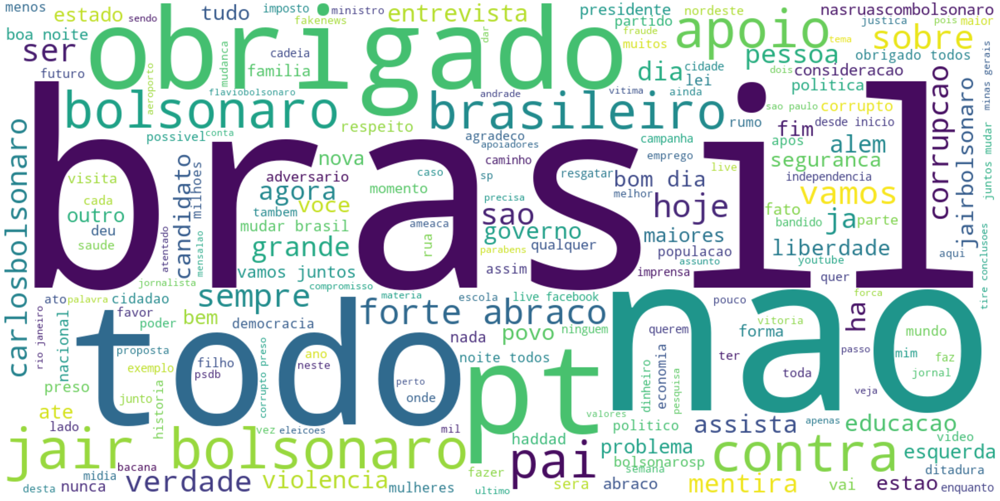

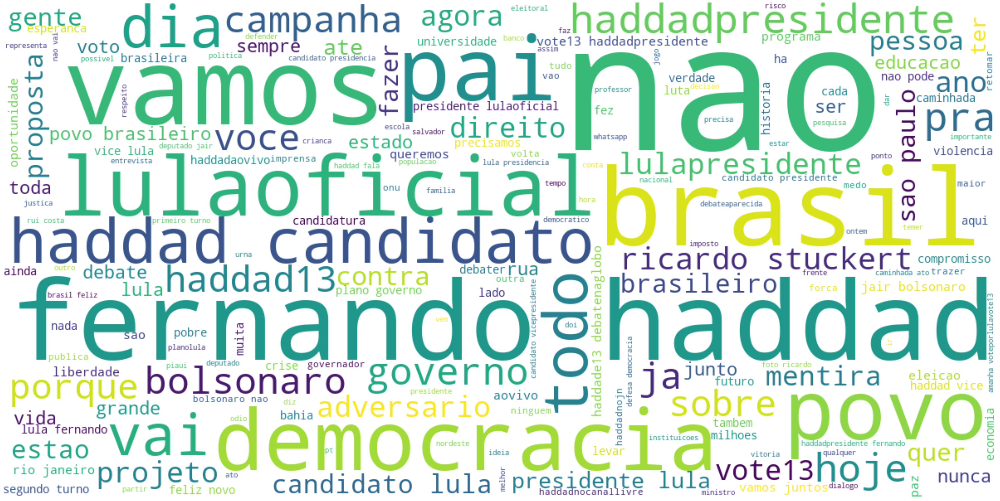

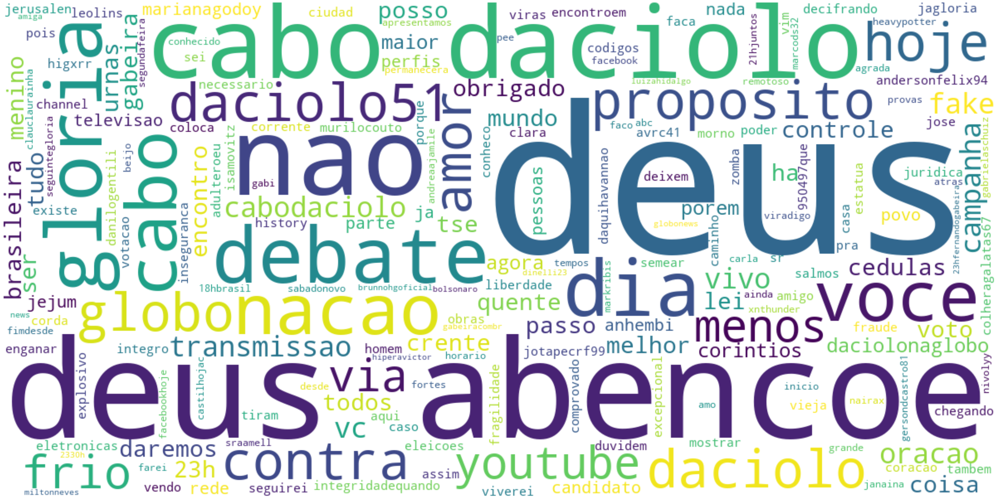

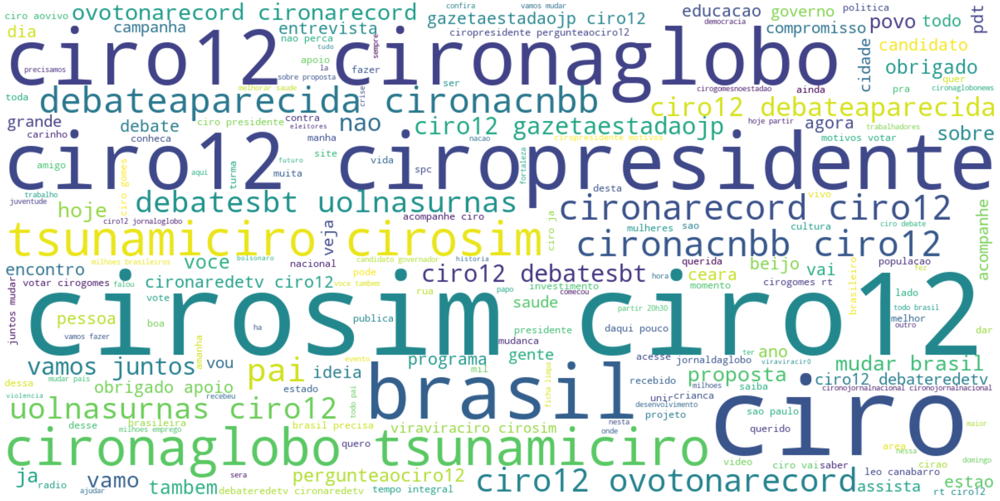

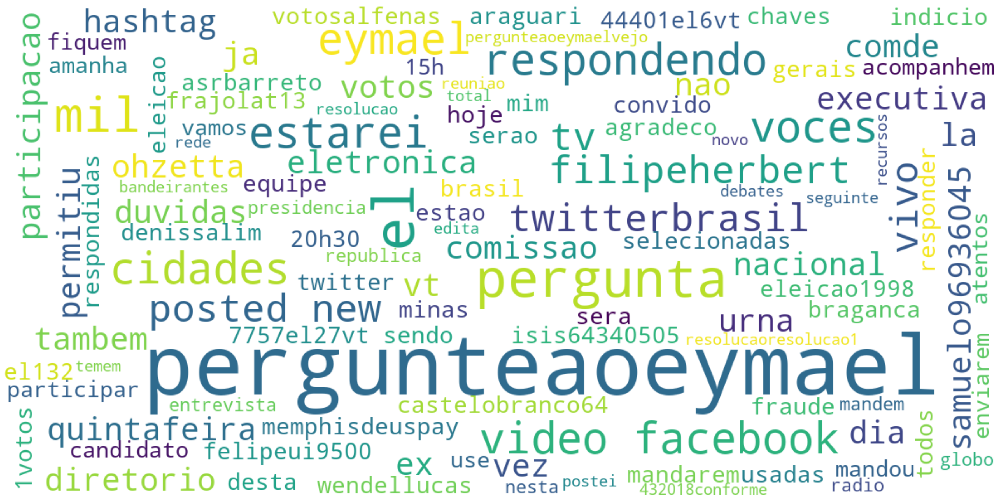

...

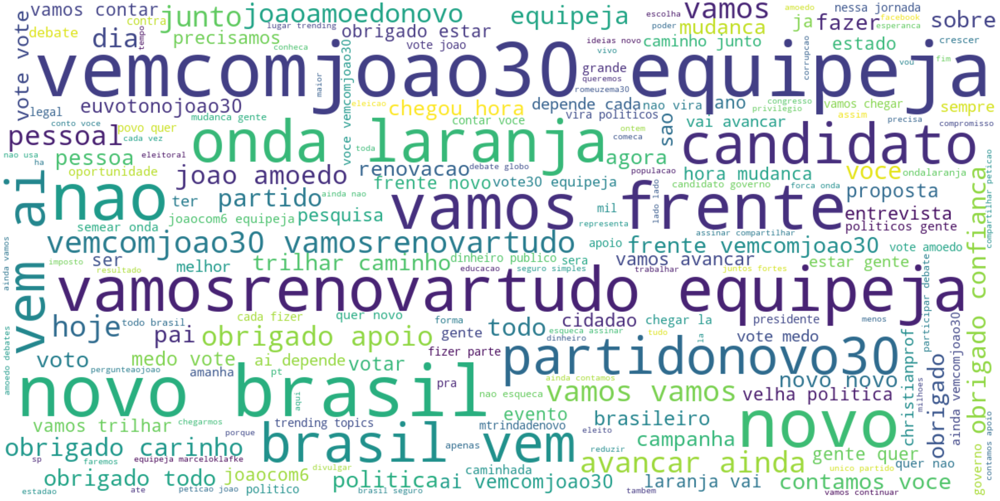

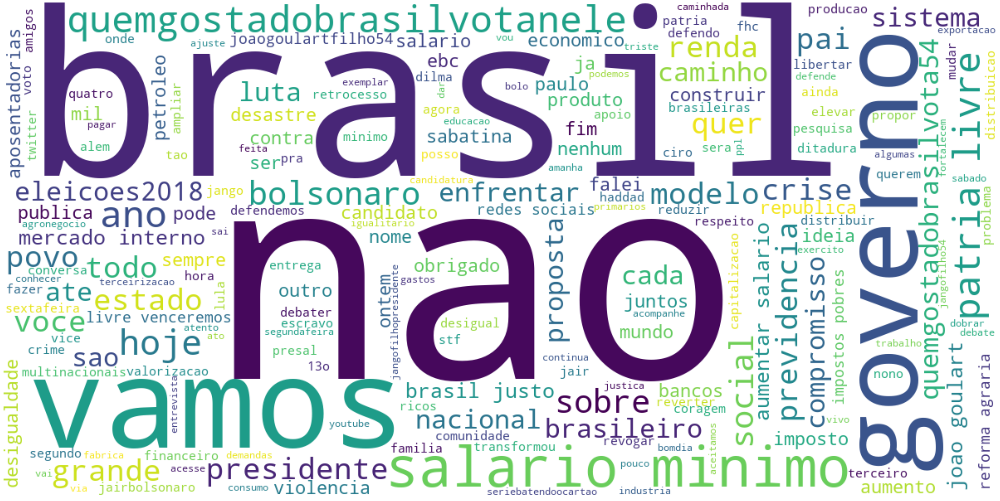

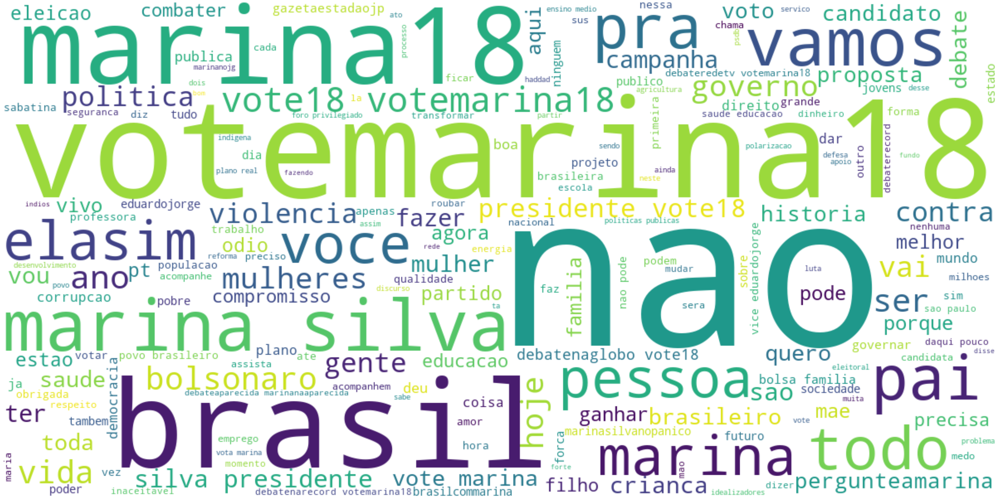

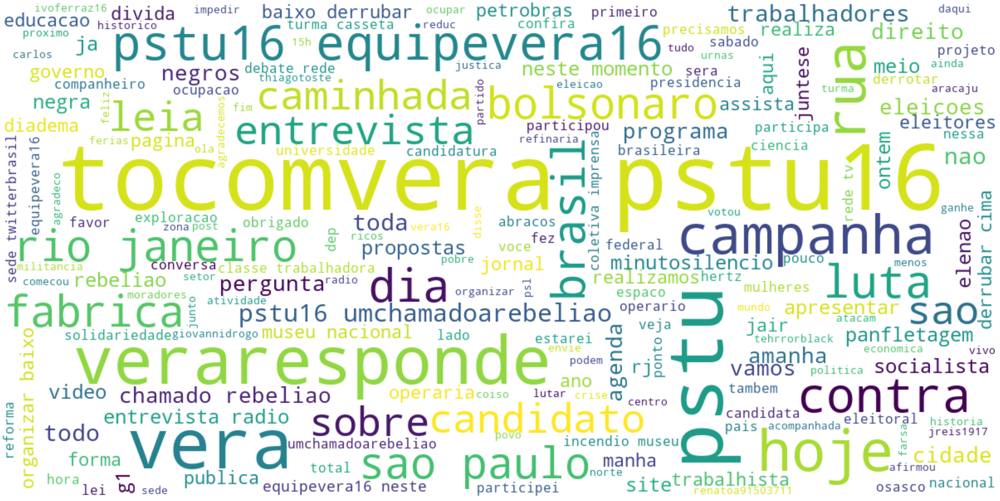

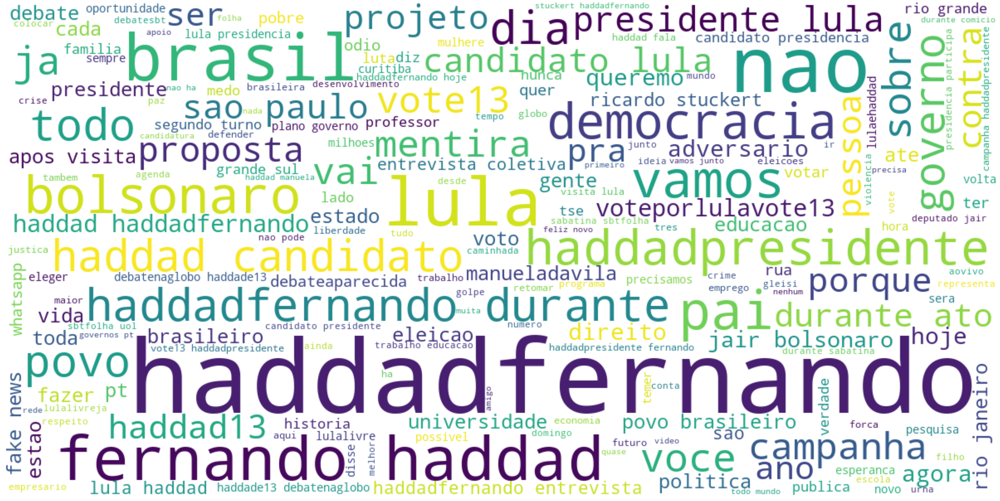

In [20]:
for i, vocabulary in enumerate(vocabularies):
    wc = WordCloud(width=1200, height=600, background_color='white')
    
    try:
        df = pd.read_csv(vocabulary, header=None, delimiter=';')
    except:
        continue
    else:
        clean_string = ','.join(df.squeeze())
        
        wc.generate(clean_string)
    
        plt.figure(figsize=(50,25))
        plt.axis("off")
        plt.tight_layout()
        plt.imshow(wc, interpolation='bilinear')
        plt.savefig(f'../data/wordcloud/{candidates[i]}_wordcloud.png')